In [18]:
%runfile H3.py

In [2]:
from utils import (make_M_alphas, 
                   make_poly_from_edges, 
                   poly_equiv, tri0, tri1, tri2, cycle_poly, std_poly,
                   poly_gl2_orbit_reps, 
                   aas_triangle_gl2_orbit_reps, 
                   square_parameters, 
                   aaa_triangle_parameters, 
                   aas_triangle_parameters,
                   hexagon_parameters)
from polyhedra import all_poly_types, poly_type, poly_types

In [3]:
d = 14

In [4]:
kdata = make_k(d)
k = kdata['k']
w = kdata['w']
zero = k(0)
one = k(1)
Ireps = kdata['Ireps']
inf = cusp(infinity, k)
k.class_number()

4

In [6]:
alphas, sigmas = alpha_sigma_data(d)
#alphas = precomputed_alphas(k)
M_alphas, alpha_inv = make_M_alphas(alphas)
print("{} alphas".format(len(alphas)))

#sigmas = [cusp(s,k) for s in [oo, (w)/(2), (w + 1)/(3), (-w - 1)/(3), (-w + 1)/(3), (w - 1)/(3)]]

print("{} sigmas".format(len(sigmas)))

k = Number Field in w with defining polynomial x^2 + 14, class number 4
6 singular points: [oo, [w - 1:3], [-w + 1:3], [w:2], [-w - 1:3], [w + 1:3]]
114 covering alphas, max denom norm 56: [[w + 1:2], [-w:3], [5:w], [3:w], [-7:w + 1], [-4:w + 1], [4:w + 1], [7:w + 1], [7:w - 1], [4:w - 1], [-3:w], [-w - 1:4], [w - 1:4], [2*w - 1:4], [-w + 1:4], [w + 5:w - 2], [w + 3:w - 2], [-w - 3:w - 2], [-w - 5:w - 2], [-w + 3:w + 2], [-w + 5:w + 2], [0:1], [w:3], [-4:w - 1], [w + 1:4], [w - 7:w + 3], [-w + 2:w + 3], [-w + 8:w + 3], [w - 6:w + 3], [-w + 3:w + 3], [-w + 6:w + 3], [w - 8:w + 3], [-w + 1:w + 3], [-w + 4:w + 3], [-w + 7:w + 3], [w + 7:w - 3], [w + 4:w - 3], [w + 1:w - 3], [-w - 2:w - 3], [w + 6:w - 3], [w + 3:w - 3], [-w - 3:w - 3], [w + 8:w - 3], [w + 2:w - 3], [-w - 1:w - 3], [-w - 4:w - 3], [w - 4:w + 3], [w - 1:w + 3], [w - 3:w + 3], [w - 2:w + 3], [-w - 7:w - 3], [-w + 2:5], [-2*w + 1:5], [-2*w:5], [2*w - 1:5], [-2*w - 1:5], [w - 2:5], [-w - 2:5], [-5:w], [-w - 6:w - 3], [w + 2:5],

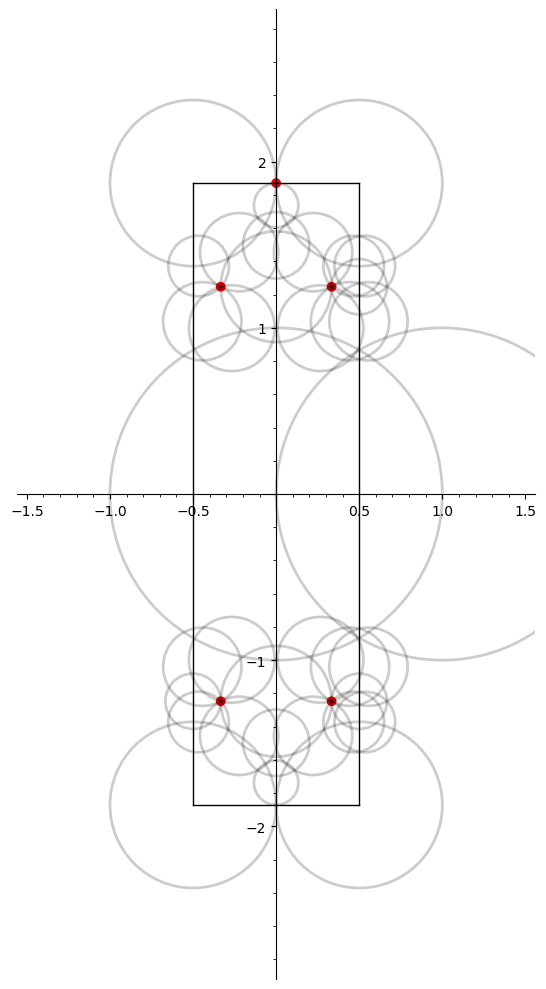

In [19]:
FD_proj = plot_FunDomain_projection(k, alphas, sigmas)
FD_proj.show(figsize=[10,10])

In [8]:
polys, hemis = all_polyhedra(k)
print("{} polyhedra constructed".format(len(polys)))

Constructing principal polyhedra
Found 8 orbits
Orbits:
[4, 6, 7]
[16, 12, 13, 14]
[20, 21, 24, 26, 30, 31]
[8, 9, 5]
[17, 10, 11, 15]
[22, 23, 25, 27, 28, 29]
[0, 1, 2, 3]
[18, 19]
Constructed 8 polyhedra
Faces: [[4, 3, 6, 3, 3, 4, 4, 3], [3, 3, 3, 3], [3, 4, 4, 4, 3], [6, 4, 3, 3, 4, 4, 3, 3], [3, 3, 3, 3], [4, 4, 3, 3, 4], [6, 4, 4, 4, 6, 4, 4, 4], [3, 3, 3, 3]]
Constructing polyhedra from one ideal class, sigmas [[w - 1:3], [-w + 1:3]]
Found 4 orbits with representative points [[0, 3, 4], [1, 2, 5], [8, 10, 7], [9, 11, 6]]:
Constructed 4 polyhedra
Faces: [[3, 3, 3, 3], [3, 3, 3, 3], [3, 3, 3, 3], [3, 3, 3, 3]]
Constructing polyhedra from one ideal class, sigmas [[w:2]]
Found 1 orbits with representative points [[0, 1, 2, 3]]:
Constructed 1 polyhedra
Faces: [[3, 3, 4, 3, 3]]
Constructing polyhedra from one ideal class, sigmas [[-w - 1:3], [w + 1:3]]
Found 4 orbits with representative points [[0, 3, 4], [8, 11, 7], [1, 2, 5], [9, 10, 6]]:
Constructed 4 polyhedra
Faces: [[3, 3, 3, 3],

In [20]:
poly_types(polys)

{'tetrahedron': 11,
 'cube': 0,
 'octahedron': 0,
 'triangular prism': 2,
 'square prism': 1,
 'hexagonal prism': 1,
 'hexagonal cap': 2,
 'truncated tetrahedron': 0,
 'cuboctahedron': 0,
 'unknown': 0}

In [21]:
all_poly_types(polys)

['hexagonal cap',
 'tetrahedron',
 'triangular prism',
 'hexagonal cap',
 'tetrahedron',
 'triangular prism',
 'hexagonal prism',
 'tetrahedron',
 'tetrahedron',
 'tetrahedron',
 'tetrahedron',
 'tetrahedron',
 'square prism',
 'tetrahedron',
 'tetrahedron',
 'tetrahedron',
 'tetrahedron']

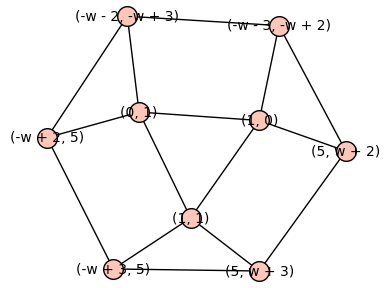

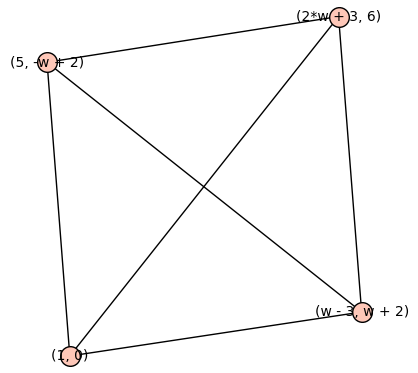

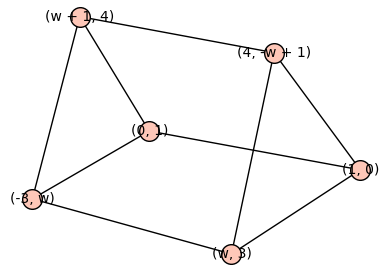

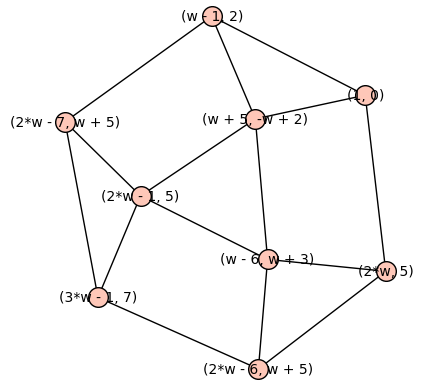

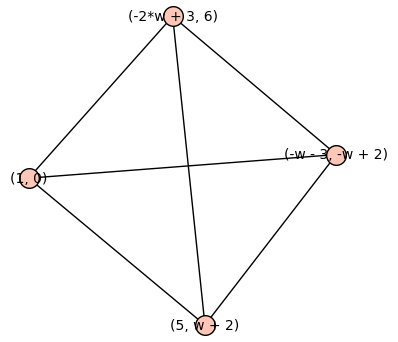

...

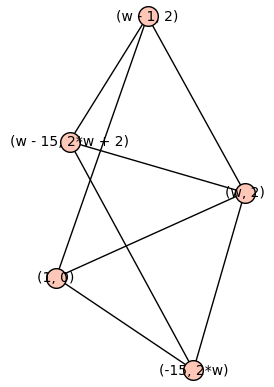

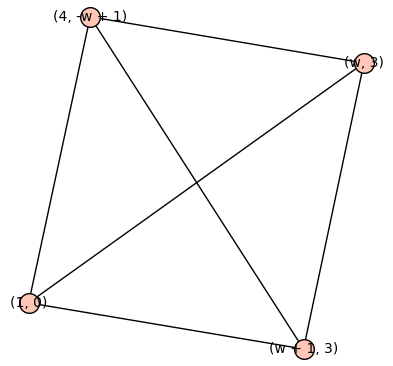

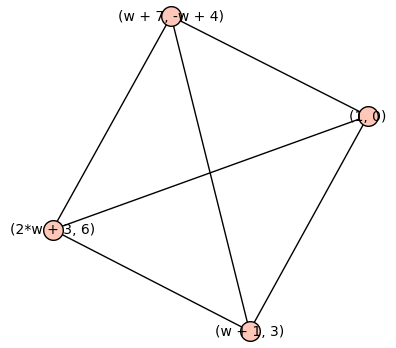

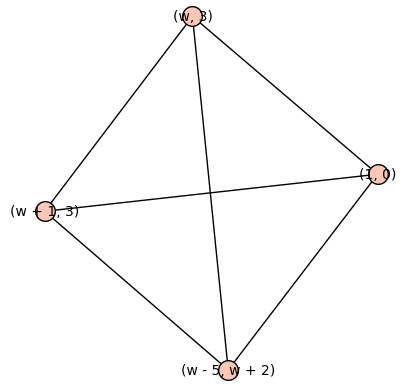

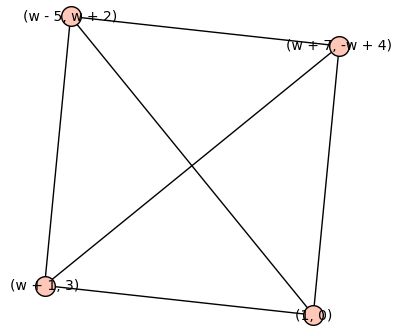

In [22]:
assert len(polys)==17
for G in polys: show(G)

In [23]:
triangles = [make_poly_from_edges(t,k) for t in sum([[F for F in G.faces() if len(F)==3] for G in polys],[])]
squares = [make_poly_from_edges(t,k) for t in sum([[F for F in G.faces() if len(F)==4] for G in polys],[])]
hexagons = [make_poly_from_edges(t,k) for t in sum([[F for F in G.faces() if len(F)==6] for G in polys],[])]
aaa_triangles = [T for T in triangles if is_poly_principal(T)]
aas_triangles = [T for T in triangles if not is_poly_principal(T)]

In [24]:
[len(t) for t in [aaa_triangles, aas_triangles, squares, hexagons]]

[32, 28, 19, 4]

In [25]:
aaa_triangles0 = poly_gl2_orbit_reps(aaa_triangles, alphas)
aas_triangles0 = aas_triangle_gl2_orbit_reps(aas_triangles, alphas)
squares0 = poly_gl2_orbit_reps(squares, alphas)
hexagons0 = poly_gl2_orbit_reps(hexagons, alphas)

In [26]:
[len(t) for t in [aaa_triangles0, aas_triangles0, squares0, hexagons0]]

[7, 12, 5, 1]

In [33]:
triangles0 = [T for T in aaa_triangles0 if any(poly_equiv(T, t) for t in [tri0(k), tri1(k), tri2(k)])]
triangles1 = [T for T in aaa_triangles0 if not any(poly_equiv(T, t) for t in [tri0(k), tri1(k), tri2(k)])]
triangles0, triangles1

([[[0:1], oo, [1:-1]]],
 [[[w + 3:w - 2], oo, [5:w + 2]],
  [[w - 3:w + 2], oo, [2*w + 3:6]],
  [[w + 7:w - 4], oo, [2*w - 3:-w - 4]],
  [[w + 5:-w + 2], oo, [w - 7:w + 4]],
  [[w:3], oo, [4:-w - 1]],
  [[-w + 3:w + 2], oo, [-4:-w + 1]]])

In [28]:
aaa = [aaa_triangle_parameters(T, alphas, M_alphas) for T in triangles1]

14 T 24 1 21 0 0
14 T 22 12 9 0 0
14 T 1 9 10 0 0
14 T 19 10 12 0 0
14 T 2 7 18 0 0
14 T 23 4 3 0 0


In [29]:
aas = [aas_triangle_parameters(T, alphas, M_alphas, sigmas) for T in aas_triangles0]

14 U 7 5 4 0 0
14 U 20 4 4 0 0
14 U 3 4 5 0 0
14 U 13 4 5 -1 0
14 U 10 5 4 0 0
14 U 1 1 1 1 0
14 U 14 1 1 0 -1
14 U 3 3 2 0 0
14 U 23 3 3 0 0
14 U 5 2 3 0 0
14 U 8 3 2 0 0
14 U 12 2 3 0 0


In [30]:
squ = [square_parameters(S, alphas, M_alphas, alpha_inv) for S in squares0]

14 Q 17 23 0 18 0 0 0 0 0 0
14 Q 17 2 0 3 0 0 0 0 0 0
14 Q 0 4 0 7 0 0 0 0 0 0
14 Q 14 1 15 1 1 1 0 0 0 -1
14 Q 16 14 17 15 0 0 0 0 0 0


In [31]:
hex = [hexagon_parameters(H, alphas, M_alphas) for H in hexagons0]

14 H 1 17 17 1 1 17 1 1 0 1 -1 -1 0 -1 1 1


In [32]:
plot_Bianchi_diagram(k,hemis)

Graphics3d Object